In [9]:
import warnings
warnings.filterwarnings('ignore')

import koreanize_matplotlib

In [1]:
import pandas as pd

building_info = pd.read_csv('Data/building_info.csv')
building_info

,건물번호,건물유형,연면적(m2),냉방면적(m2),태양광용량(kW),ESS저장용량(kWh),PCS용량(kW)
0,1,호텔,82912.71,77586.00,-,-,-
1,2,상용,40658.90,30392.82,-,-,-
2,3,병원,560431.00,418992.00,278.58,-,-
3,4,호텔,41813.29,23715.71,-,-,-
4,5,학교,403749.39,248507.00,1983.05,1025,250
...,...,...,...,...,...,...,...
95,96,건물기타,3260213.41,1956128.00,-,-,-
96,97,건물기타,42370.93,3975.52,81.38,-,-
97,98,호텔,99102.62,22097.00,-,-,-
98,99,상용,329867.95,13442.35,171.6,-,-


# info 확인 후 정리하기


In [3]:
building_info['건물유형'].unique()

array(['호텔', '상용', '병원', '학교', '건물기타', '아파트', '연구소', '백화점', 'IDC(전화국)',
       '공공'], dtype=object)

# Train data 확인

In [2]:
train = pd.read_csv('Data/train.csv')
train

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh)
0,1_20240601 00,1,20240601 00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80
1,1_20240601 01,1,20240601 01,18.3,0.0,2.7,82.0,0.0,0.00,5591.85
2,1_20240601 02,1,20240601 02,18.1,0.0,2.6,80.0,0.0,0.00,5338.17
3,1_20240601 03,1,20240601 03,18.0,0.0,2.6,81.0,0.0,0.00,4554.42
4,1_20240601 04,1,20240601 04,17.8,0.0,1.3,81.0,0.0,0.00,3602.25
...,...,...,...,...,...,...,...,...,...,...
203995,100_20240824 19,100,20240824 19,29.1,0.0,4.4,76.0,0.4,0.18,3276.00
203996,100_20240824 20,100,20240824 20,28.6,0.0,3.7,74.0,0.0,0.00,3197.52
203997,100_20240824 21,100,20240824 21,28.3,0.0,2.9,74.0,0.0,0.00,3006.60
203998,100_20240824 22,100,20240824 22,28.0,0.0,1.7,76.0,0.0,0.00,2649.72


In [4]:
train_c1 = train.merge(building_info[['건물번호','건물유형']], on = '건물번호', how =  'left')
train_c1

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),건물유형
0,1_20240601 00,1,20240601 00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,호텔
1,1_20240601 01,1,20240601 01,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,호텔
2,1_20240601 02,1,20240601 02,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,호텔
3,1_20240601 03,1,20240601 03,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,호텔
4,1_20240601 04,1,20240601 04,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,호텔
...,...,...,...,...,...,...,...,...,...,...,...
203995,100_20240824 19,100,20240824 19,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,호텔
203996,100_20240824 20,100,20240824 20,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,호텔
203997,100_20240824 21,100,20240824 21,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,호텔
203998,100_20240824 22,100,20240824 22,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,호텔


In [6]:
sample = train_c1.groupby('건물유형')['전력소비량(kWh)'].mean()
sample

건물유형
IDC(전화국)    10316.944618
건물기타         2285.963948
공공           1625.914862
백화점          2729.738252
병원           4454.059004
상용           2513.698044
아파트          1106.309105
연구소          2111.671770
학교           3462.680492
호텔           3175.016948
Name: 전력소비량(kWh), dtype: float64

<Axes: xlabel='건물유형', ylabel='전력소비량(kWh)'>

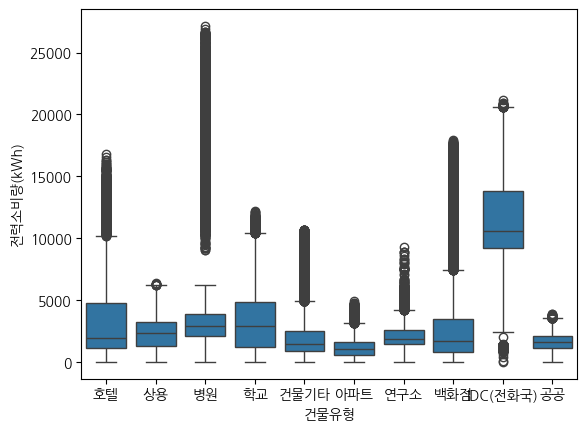

In [10]:
import seaborn as sns

sns.boxplot(x = '건물유형', y = '전력소비량(kWh)', data = train_c1)

In [14]:
train_c1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204000 entries, 0 to 203999
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   num_date_time  204000 non-null  object 
 1   건물번호           204000 non-null  int64  
 2   일시             204000 non-null  object 
 3   기온(°C)         204000 non-null  float64
 4   강수량(mm)        204000 non-null  float64
 5   풍속(m/s)        204000 non-null  float64
 6   습도(%)          204000 non-null  float64
 7   일조(hr)         204000 non-null  float64
 8   일사(MJ/m2)      204000 non-null  float64
 9   전력소비량(kWh)     204000 non-null  float64
 10  건물유형           204000 non-null  object 
dtypes: float64(7), int64(1), object(3)
memory usage: 17.1+ MB


In [15]:
train_c1['num_date_time']

0           1_20240601 00
1           1_20240601 01
2           1_20240601 02
3           1_20240601 03
4           1_20240601 04
               ...       
203995    100_20240824 19
203996    100_20240824 20
203997    100_20240824 21
203998    100_20240824 22
203999    100_20240824 23
Name: num_date_time, Length: 204000, dtype: object

In [19]:
train_c1['num_date_time'] = train_c1['num_date_time'].str.split(' ')

In [20]:
train_c1['일자'] = train_c1['num_date_time'].apply(lambda x: x[0].split('_')[1])
train_c1['시간'] = train_c1['num_date_time'].apply(lambda x: x[1])
train_c1

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),건물유형,일자,시간
0,"[1_20240601, 00]",1,20240601 00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,호텔,20240601,00
1,"[1_20240601, 01]",1,20240601 01,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,호텔,20240601,01
2,"[1_20240601, 02]",1,20240601 02,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,호텔,20240601,02
3,"[1_20240601, 03]",1,20240601 03,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,호텔,20240601,03
4,"[1_20240601, 04]",1,20240601 04,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,호텔,20240601,04
...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,"[100_20240824, 19]",100,20240824 19,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,호텔,20240824,19
203996,"[100_20240824, 20]",100,20240824 20,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,호텔,20240824,20
203997,"[100_20240824, 21]",100,20240824 21,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,호텔,20240824,21
203998,"[100_20240824, 22]",100,20240824 22,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,호텔,20240824,22


In [23]:
train_c1['일시'] = pd.to_datetime(train_c1['일시'])
train_c1['일시']

0        2024-06-01 00:00:00
1        2024-06-01 01:00:00
2        2024-06-01 02:00:00
3        2024-06-01 03:00:00
4        2024-06-01 04:00:00
                 ...        
203995   2024-08-24 19:00:00
203996   2024-08-24 20:00:00
203997   2024-08-24 21:00:00
203998   2024-08-24 22:00:00
203999   2024-08-24 23:00:00
Name: 일시, Length: 204000, dtype: datetime64[ns]

In [26]:
# 일시 컬럼에서 요일 추출
train_c1['요일'] = train_c1['일시'].dt.day_name() 
train_c1

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),건물유형,일자,시간,요일
0,"[1_20240601, 00]",1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,호텔,20240601,00,Saturday
1,"[1_20240601, 01]",1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,호텔,20240601,01,Saturday
2,"[1_20240601, 02]",1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,호텔,20240601,02,Saturday
3,"[1_20240601, 03]",1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,호텔,20240601,03,Saturday
4,"[1_20240601, 04]",1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,호텔,20240601,04,Saturday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,"[100_20240824, 19]",100,2024-08-24 19:00:00,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,호텔,20240824,19,Saturday
203996,"[100_20240824, 20]",100,2024-08-24 20:00:00,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,호텔,20240824,20,Saturday
203997,"[100_20240824, 21]",100,2024-08-24 21:00:00,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,호텔,20240824,21,Saturday
203998,"[100_20240824, 22]",100,2024-08-24 22:00:00,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,호텔,20240824,22,Saturday


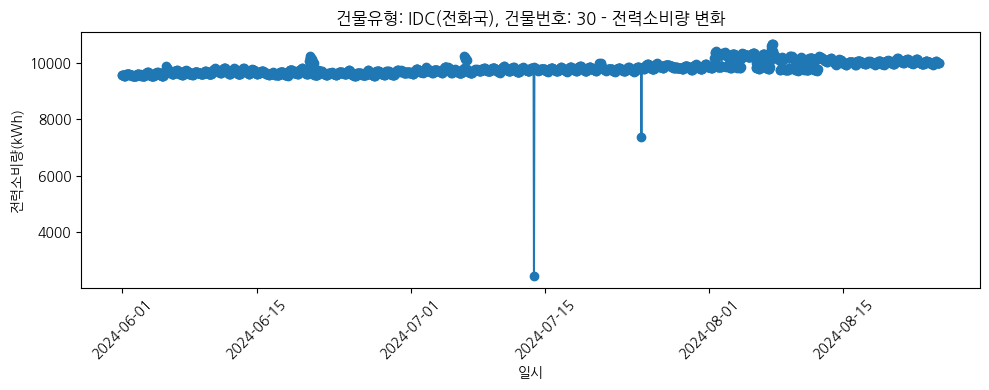

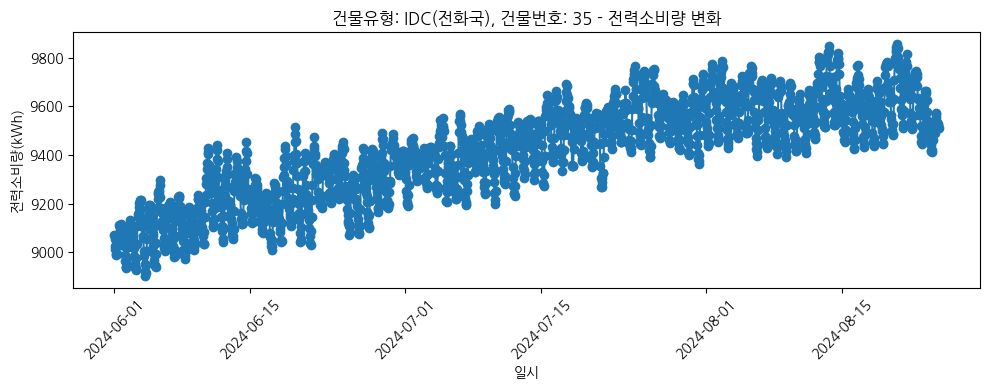

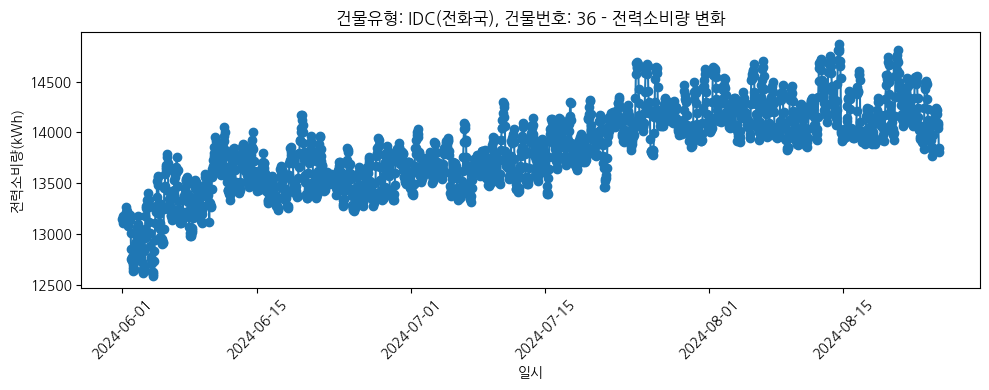

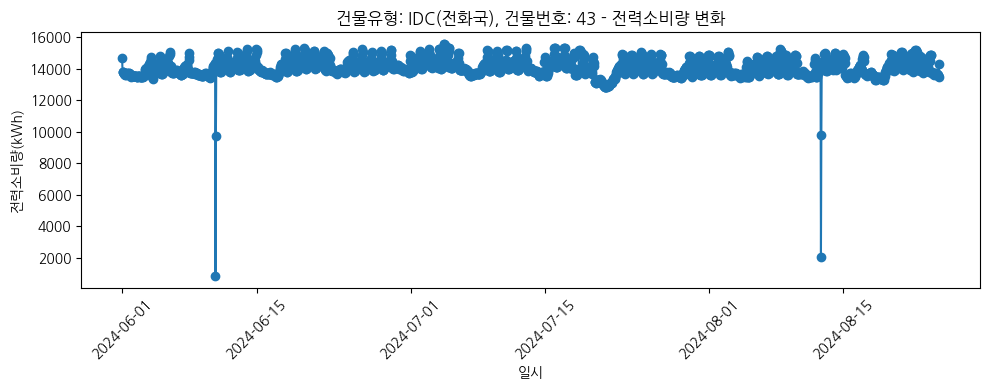

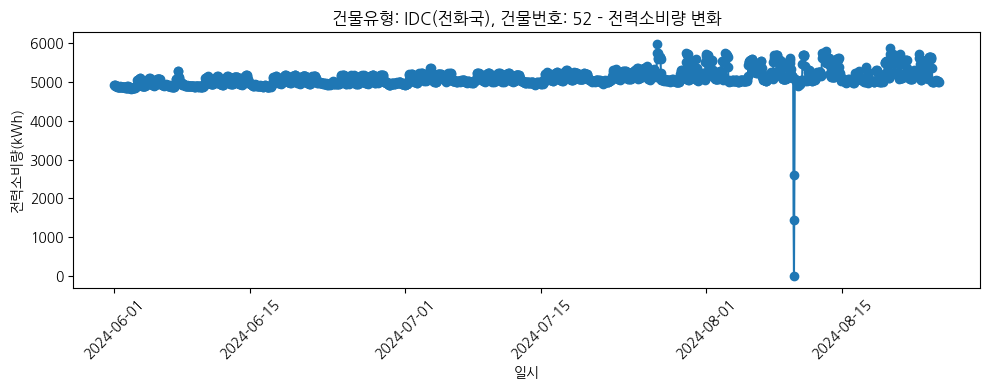

...

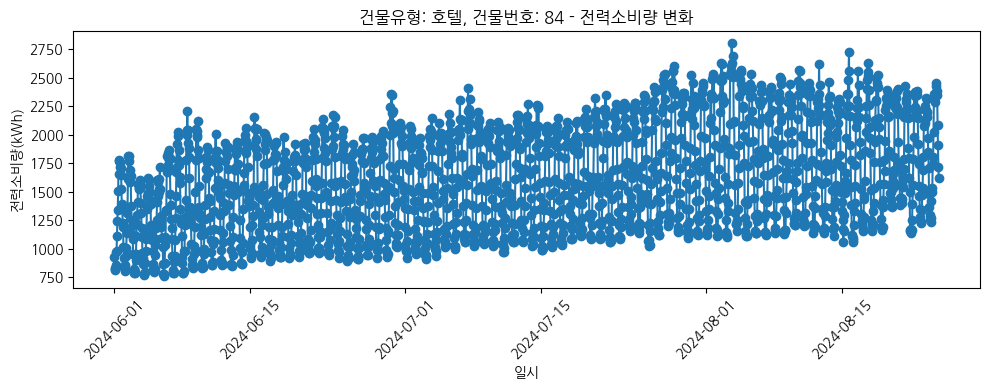

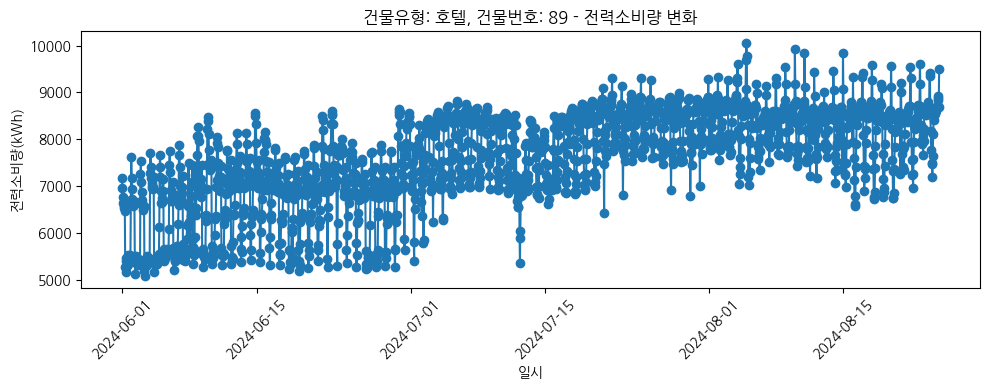

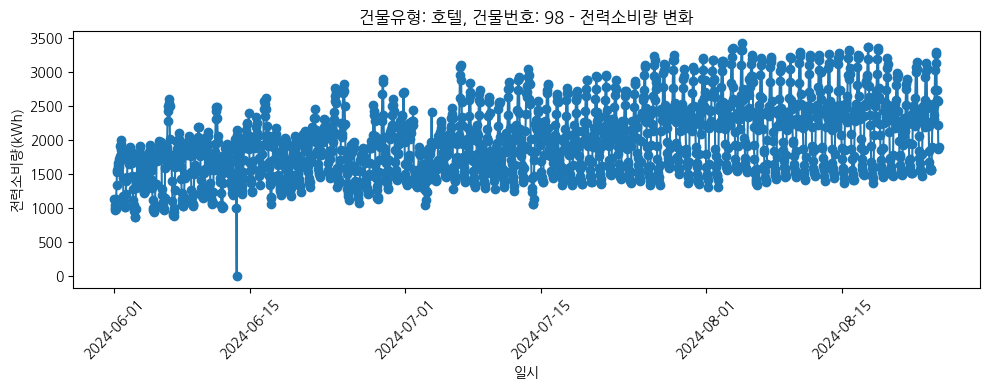

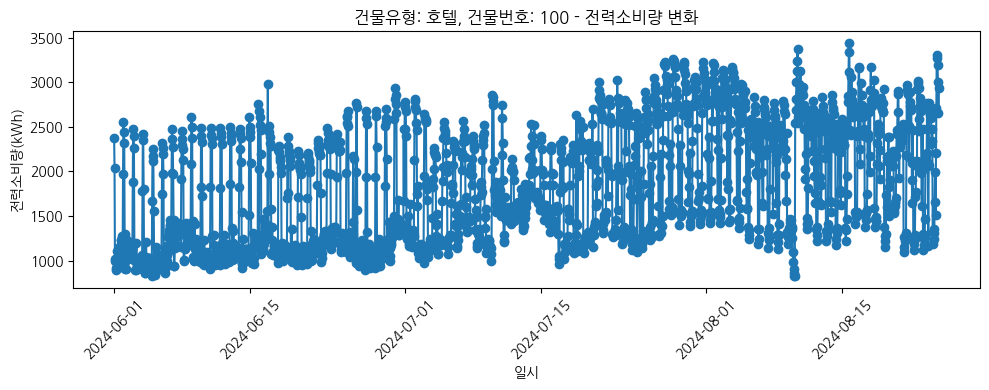

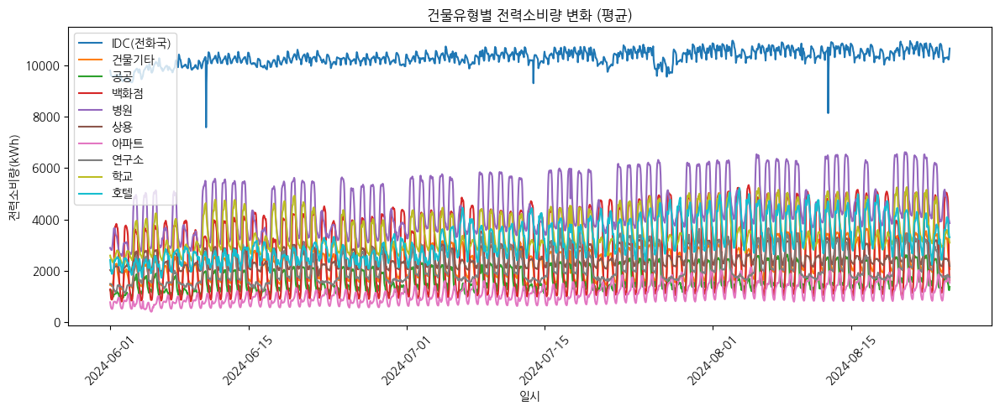

In [25]:
import matplotlib.pyplot as plt

df =  train_c1.copy()

for (b_type, b_num), group in df.groupby(['건물유형', '건물번호']):
    plt.figure(figsize=(10,4))
    plt.plot(group['일시'], group['전력소비량(kWh)'], marker='o')
    plt.title(f'건물유형: {b_type}, 건물번호: {b_num} - 전력소비량 변화')
    plt.xlabel('일시')
    plt.ylabel('전력소비량(kWh)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    # break  # 전체 다 그리고 싶지 않으면 break 추가

# 건물유형별 평균변화 (여러 라인 한 그래프에 그리기)
plt.figure(figsize=(12,5))
for b_type, group in df.groupby('건물유형'):
    df_grouped = group.groupby('일시')['전력소비량(kWh)'].mean()
    plt.plot(df_grouped.index, df_grouped.values, label=b_type)
plt.title('건물유형별 전력소비량 변화 (평균)')
plt.xlabel('일시')
plt.ylabel('전력소비량(kWh)')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


요일별 주기성이 존재해 보이는데 세부 건물번호에따라서만 주기성이 존재하는것처럼 보이기도 함. 

### 건물 유형별 주기성 확인

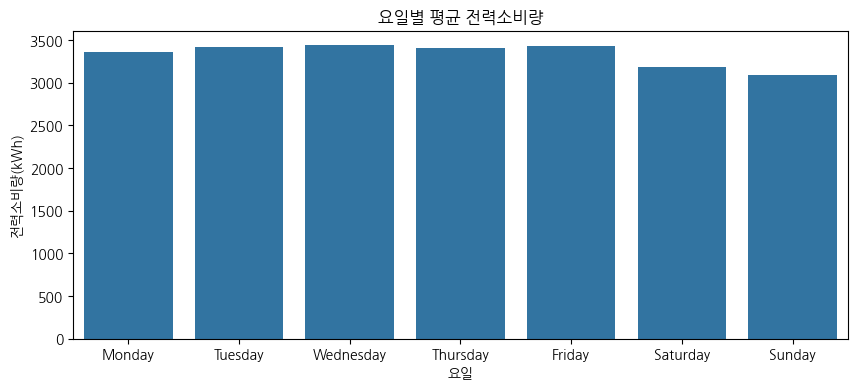

In [30]:
weekday_mean = train_c1.groupby('요일')['전력소비량(kWh)'].mean().reindex(
    ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# 그래프
plt.figure(figsize=(10,4))
sns.barplot(x=weekday_mean.index, y=weekday_mean.values)
plt.title('요일별 평균 전력소비량')
plt.ylabel('전력소비량(kWh)')
plt.xlabel('요일')
plt.show()


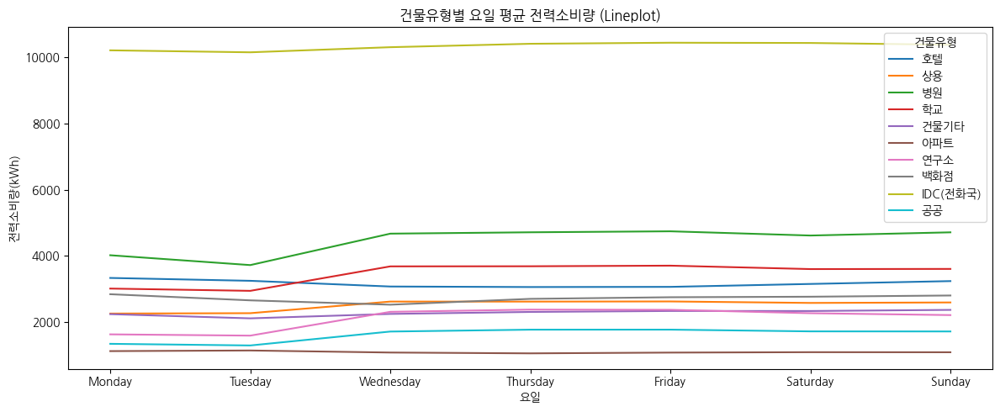

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

plt.figure(figsize=(12, 5))
sns.lineplot(
    data=df,
    x='요일',
    y='전력소비량(kWh)',
    hue='건물유형',
    estimator='mean',  # 각 그룹별 평균
    errorbar=None,     # 신뢰구간 생략(원하면 제거)
    sort=False,
    markers=True
)
plt.title('건물유형별 요일 평균 전력소비량 (Lineplot)')
plt.ylabel('전력소비량(kWh)')
plt.xlabel('요일')
plt.xticks(ticks=range(7), labels=order)
plt.legend(title='건물유형')
plt.tight_layout()
plt.show()


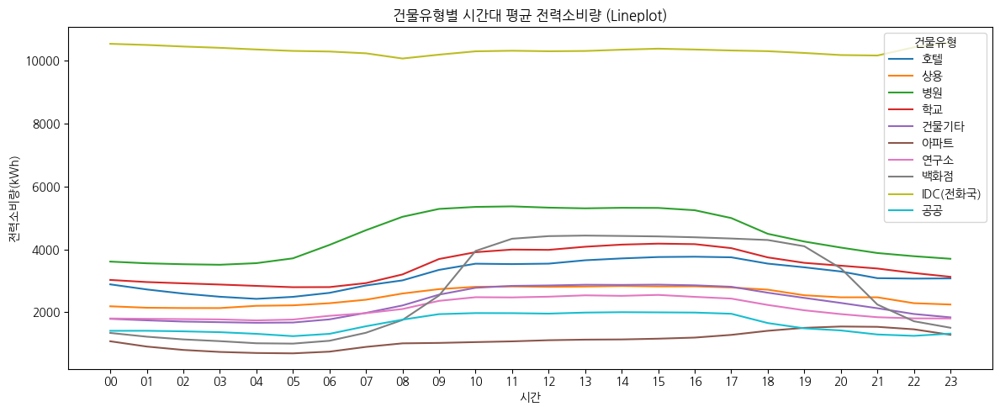

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 5))
sns.lineplot(
    data=df,
    x='시간',   # x축: 0~23 (int 또는 str 가능)
    y='전력소비량(kWh)',
    hue='건물유형',
    estimator='mean',
    errorbar=None,
    markers=True
)
plt.title('건물유형별 시간대 평균 전력소비량 (Lineplot)')
plt.ylabel('전력소비량(kWh)')
plt.xlabel('시간')
plt.xticks(range(0, 24))
plt.legend(title='건물유형')
plt.tight_layout()
plt.show()


### 건물번호별 주기성 확인

In [48]:
import pandas as pd
import numpy as np

period = 168  # 일주일(7*24시간)
threshold = 0.5  # 주기성 강도의 기준값, 필요에 따라 조정

weekly_seasonal_buildings = []

for (b_type, b_num), group in df.groupby('건물유형', '건물번호']):
    group_sorted = group.sort_values('일시')
    vals = group_sorted['전력소비량(kWh)'].values
    if len(vals) > 2 * period:  # 데이터가 두 주기(2*168) 이상인 경우
        autocorr = pd.Series(vals).autocorr(lag=period)
        if autocorr and abs(autocorr) > threshold:
            weekly_seasonal_buildings.append((b_type, b_num, autocorr))

# 결과 확인 (주기성이 높은 순 정렬)
weekly_seasonal_buildings = sorted(weekly_seasonal_buildings, key=lambda x: -abs(x[2]))
print('일주일 단위 주기성 강한 건물:')
for b_type, b_num, score in weekly_seasonal_buildings:
    print(f'{b_type}, {b_num}: autocorr(168)={score:.2f}')


일주일 단위 주기성 강한 건물:
34: autocorr(168)=0.99
73: autocorr(168)=0.99
88: autocorr(168)=0.99
18: autocorr(168)=0.99
82: autocorr(168)=0.98
92: autocorr(168)=0.98
58: autocorr(168)=0.98
84: autocorr(168)=0.97
47: autocorr(168)=0.97
86: autocorr(168)=0.96
45: autocorr(168)=0.96
61: autocorr(168)=0.96
66: autocorr(168)=0.96
3: autocorr(168)=0.96
79: autocorr(168)=0.95
85: autocorr(168)=0.95
11: autocorr(168)=0.95
96: autocorr(168)=0.95
93: autocorr(168)=0.95
71: autocorr(168)=0.95
74: autocorr(168)=0.95
31: autocorr(168)=0.95
78: autocorr(168)=0.95
19: autocorr(168)=0.95
14: autocorr(168)=0.95
60: autocorr(168)=0.94
39: autocorr(168)=0.94
28: autocorr(168)=0.94
16: autocorr(168)=0.94
65: autocorr(168)=0.94
75: autocorr(168)=0.93
37: autocorr(168)=0.93
9: autocorr(168)=0.93
91: autocorr(168)=0.93
95: autocorr(168)=0.93
44: autocorr(168)=0.93
6: autocorr(168)=0.93
42: autocorr(168)=0.93
2: autocorr(168)=0.93
4: autocorr(168)=0.93
38: autocorr(168)=0.92
35: autocorr(168)=0.92
20: autocorr(168)=0.9

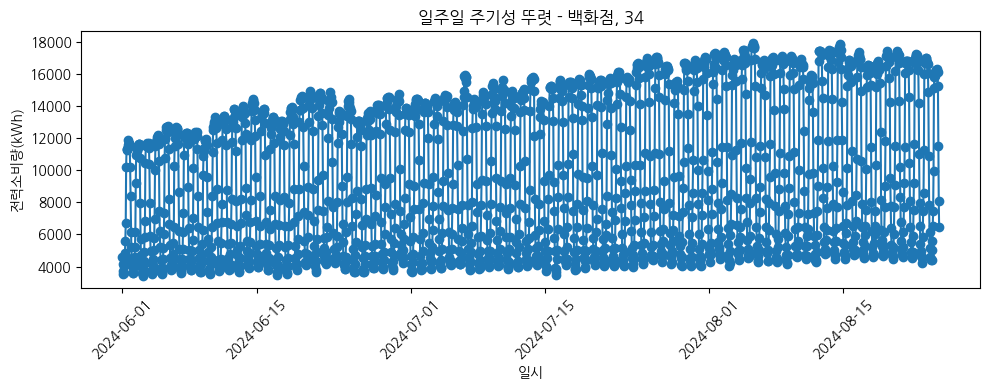

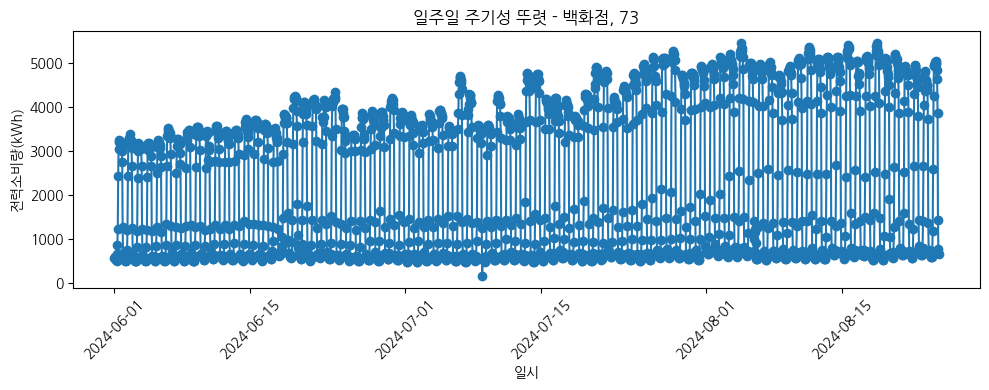

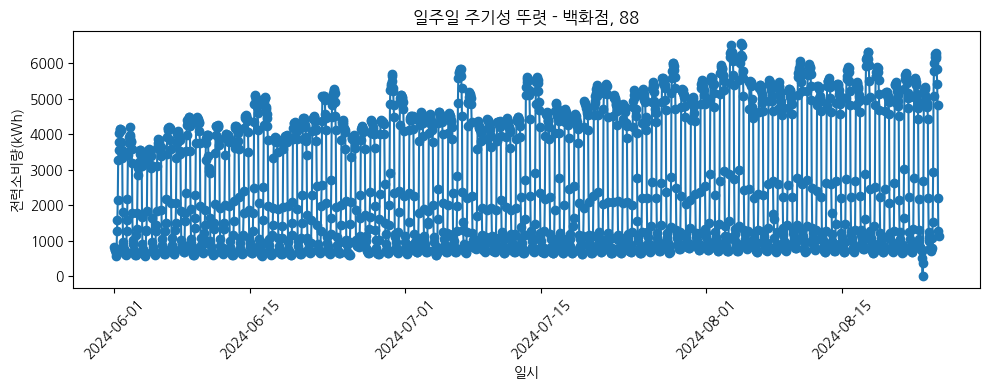

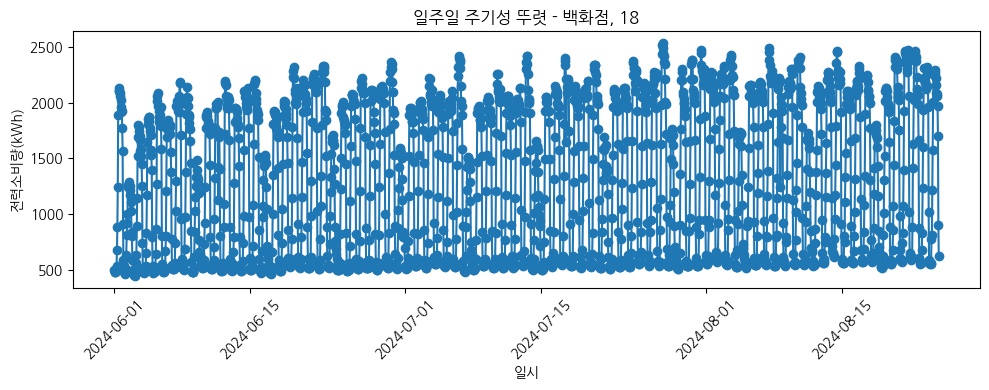

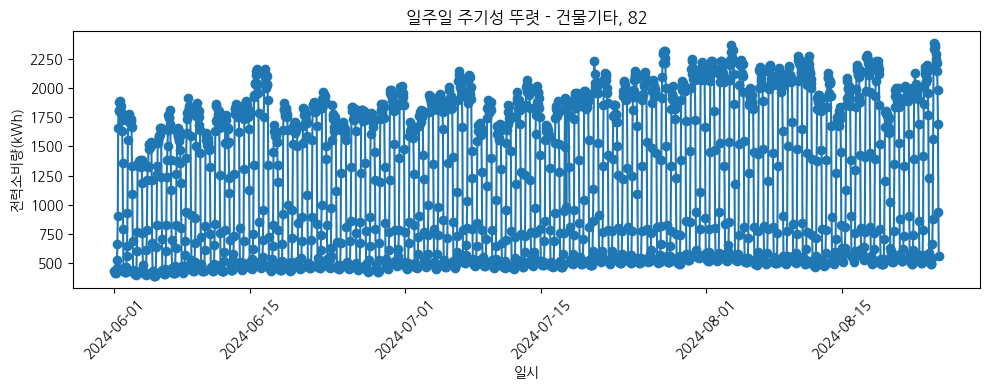

...

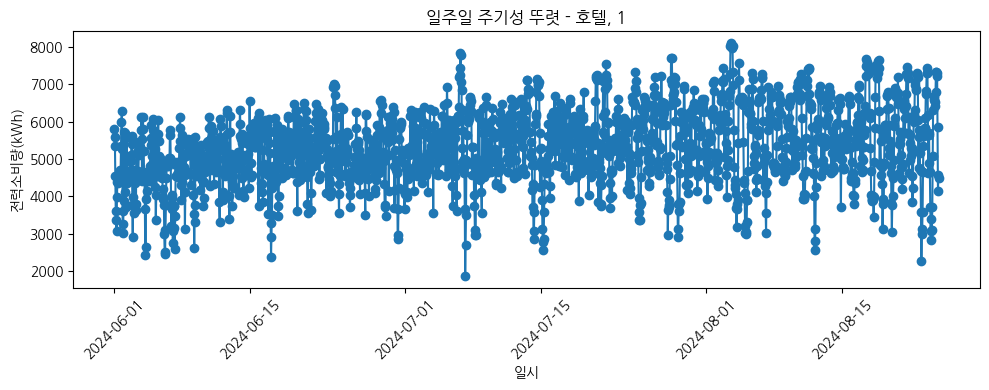

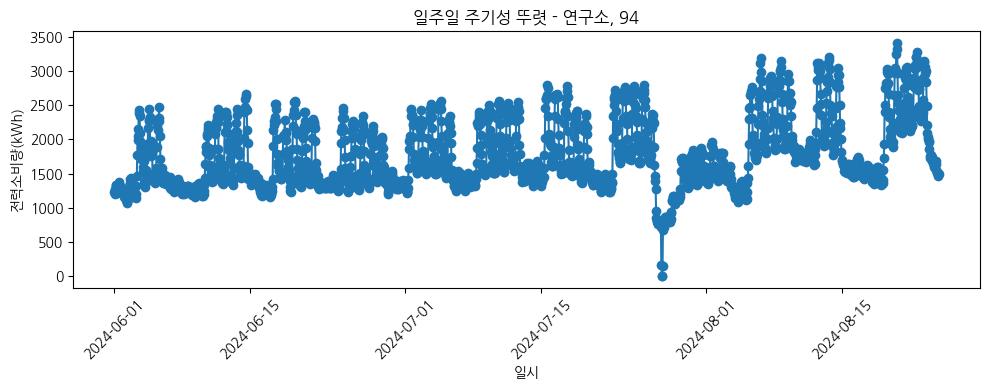

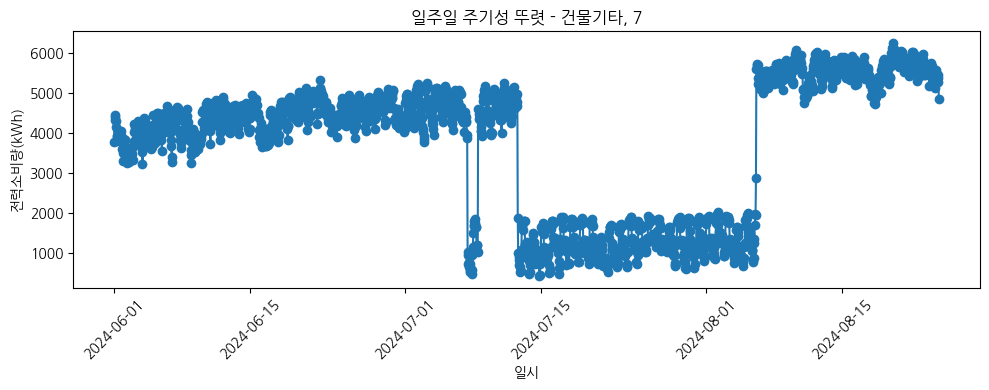

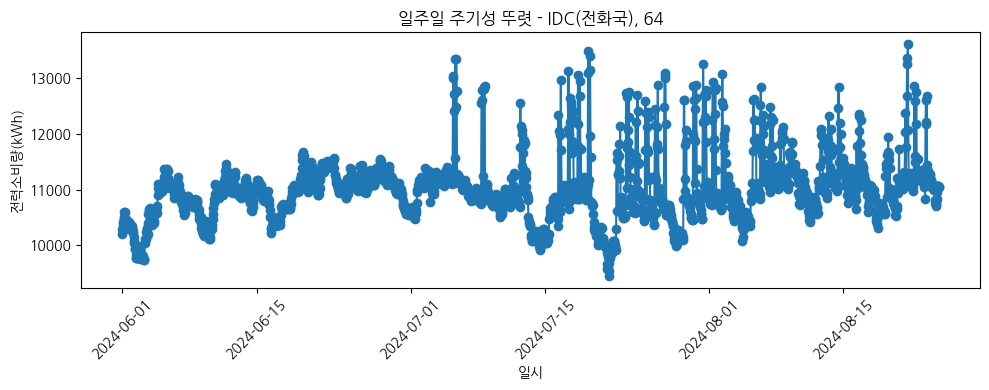

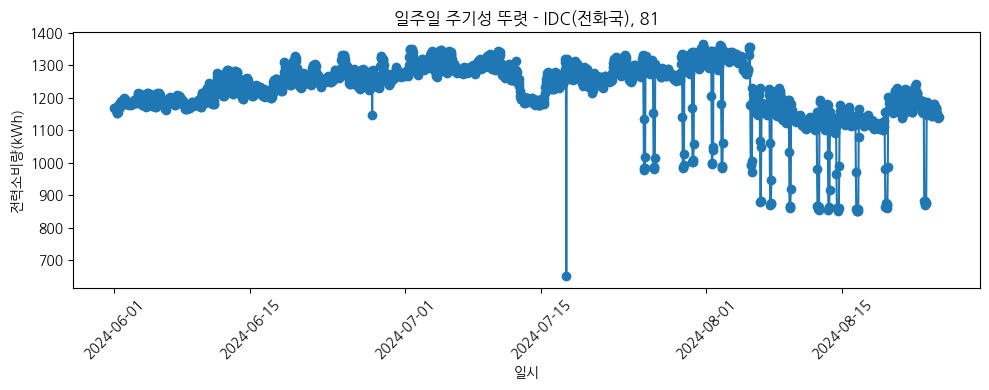

In [40]:
for b_type, b_num, _ in weekly_seasonal_buildings:
    group = df[(df['건물유형'] == b_type) & (df['건물번호'] == b_num)].sort_values('일시')
    plt.figure(figsize=(10, 4))
    plt.plot(group['일시'], group['전력소비량(kWh)'], marker='o')
    plt.title(f'일주일 주기성 뚜렷 - {b_type}, {b_num}')
    plt.xlabel('일시')
    plt.ylabel('전력소비량(kWh)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [52]:
train_c1['시간'] = train_c1['일시'].dt.hour
train_c1['요일'] = train_c1['일시'].dt.dayofweek #Monday = 0
train_c1['일자'] = train_c1['일시'].dt.day

train_c1

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),건물유형,일자,시간,요일
0,"[1_20240601, 00]",1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,호텔,1,0,5
1,"[1_20240601, 01]",1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,호텔,1,1,5
2,"[1_20240601, 02]",1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,호텔,1,2,5
3,"[1_20240601, 03]",1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,호텔,1,3,5
4,"[1_20240601, 04]",1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,호텔,1,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,"[100_20240824, 19]",100,2024-08-24 19:00:00,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,호텔,24,19,5
203996,"[100_20240824, 20]",100,2024-08-24 20:00:00,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,호텔,24,20,5
203997,"[100_20240824, 21]",100,2024-08-24 21:00:00,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,호텔,24,21,5
203998,"[100_20240824, 22]",100,2024-08-24 22:00:00,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,호텔,24,22,5


In [53]:
import numpy as np # 순환성을 반영할 필요가 있어서 

train_c1['시간_sin'] = np.sin(2 * np.pi * train_c1['시간'] / 24)
train_c1['시간_cos'] = np.cos(2 * np.pi * train_c1['시간'] / 24)
train_c1['요일_sin'] = np.sin(2 * np.pi * train_c1['요일'] / 7)
train_c1['요일_cos'] = np.cos(2 * np.pi * train_c1['요일'] / 7)


In [54]:
train_c1

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),건물유형,일자,시간,요일,시간_sin,시간_cos,요일_sin,요일_cos
0,"[1_20240601, 00]",1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,호텔,1,0,5,0.000000,1.000000,-0.974928,-0.222521
1,"[1_20240601, 01]",1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,호텔,1,1,5,0.258819,0.965926,-0.974928,-0.222521
2,"[1_20240601, 02]",1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,호텔,1,2,5,0.500000,0.866025,-0.974928,-0.222521
3,"[1_20240601, 03]",1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,호텔,1,3,5,0.707107,0.707107,-0.974928,-0.222521
4,"[1_20240601, 04]",1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,호텔,1,4,5,0.866025,0.500000,-0.974928,-0.222521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,"[100_20240824, 19]",100,2024-08-24 19:00:00,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,호텔,24,19,5,-0.965926,0.258819,-0.974928,-0.222521
203996,"[100_20240824, 20]",100,2024-08-24 20:00:00,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,호텔,24,20,5,-0.866025,0.500000,-0.974928,-0.222521
203997,"[100_20240824, 21]",100,2024-08-24 21:00:00,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,호텔,24,21,5,-0.707107,0.707107,-0.974928,-0.222521
203998,"[100_20240824, 22]",100,2024-08-24 22:00:00,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,호텔,24,22,5,-0.500000,0.866025,-0.974928,-0.222521


In [55]:
train_c2 = train_c1.merge(building_info, on = ['건물번호','건물유형'], how =  'left')
train_c2

,num_date_time,건물번호,일시,기온(°C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh),...,요일,시간_sin,시간_cos,요일_sin,요일_cos,연면적(m2),냉방면적(m2),태양광용량(kW),ESS저장용량(kWh),PCS용량(kW)
0,"[1_20240601, 00]",1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.00,5794.80,...,5,0.000000,1.000000,-0.974928,-0.222521,82912.71,77586.0,-,-,-
1,"[1_20240601, 01]",1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.00,5591.85,...,5,0.258819,0.965926,-0.974928,-0.222521,82912.71,77586.0,-,-,-
2,"[1_20240601, 02]",1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.00,5338.17,...,5,0.500000,0.866025,-0.974928,-0.222521,82912.71,77586.0,-,-,-
3,"[1_20240601, 03]",1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.00,4554.42,...,5,0.707107,0.707107,-0.974928,-0.222521,82912.71,77586.0,-,-,-
4,"[1_20240601, 04]",1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.00,3602.25,...,5,0.866025,0.500000,-0.974928,-0.222521,82912.71,77586.0,-,-,-
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,"[100_20240824, 19]",100,2024-08-24 19:00:00,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,...,5,-0.965926,0.258819,-0.974928,-0.222521,162070.24,152943.0,-,-,-
203996,"[100_20240824, 20]",100,2024-08-24 20:00:00,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,...,5,-0.866025,0.500000,-0.974928,-0.222521,162070.24,152943.0,-,-,-
203997,"[100_20240824, 21]",100,2024-08-24 21:00:00,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,...,5,-0.707107,0.707107,-0.974928,-0.222521,162070.24,152943.0,-,-,-
203998,"[100_20240824, 22]",100,2024-08-24 22:00:00,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,...,5,-0.500000,0.866025,-0.974928,-0.222521,162070.24,152943.0,-,-,-


In [58]:
# 월도 순환주기
train_c2['월'] = (train_c2['일자'] // 100) % 100
train_c2['일'] = train_c2['일자'] % 100
train_c2['월_sin'] = np.sin(2 * np.pi * train_c2['월'] / 12)
train_c2['월_cos'] = np.cos(2 * np.pi * train_c2['월'] / 12)

In [59]:
train_c2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204000 entries, 0 to 203999
Data columns (total 27 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   num_date_time  204000 non-null  object        
 1   건물번호           204000 non-null  int64         
 2   일시             204000 non-null  datetime64[ns]
 3   기온(°C)         204000 non-null  float64       
 4   강수량(mm)        204000 non-null  float64       
 5   풍속(m/s)        204000 non-null  float64       
 6   습도(%)          204000 non-null  float64       
 7   일조(hr)         204000 non-null  float64       
 8   일사(MJ/m2)      204000 non-null  float64       
 9   전력소비량(kWh)     204000 non-null  float64       
 10  건물유형           204000 non-null  object        
 11  일자             204000 non-null  int32         
 12  시간             204000 non-null  int32         
 13  요일             204000 non-null  int32         
 14  시간_sin         204000 non-null  float64       
 15  

In [62]:
train_c2.to_csv('Data/train_c20729.csv',index = False)